# CS498PS - Lab 3: Artificial Reverberation and Room Simulation


In this lab we will get some experience in simulating rooms digitally. We will design some simple reverbs using small filters and then work towards a more principled room simulator. You can use whichever sound you like for the following examples, usually a sound with sharp onsets is good for such experiments. One good example is the drum loop [ https://drive.google.com/uc?export=download&id=16mqI3xFN00AK5bP5k1VYJiEfH7ghHHSf ]

## Part 1. Designing simple reverb using filters

The simplest forms of reverbs can be designed using simple delays, comb and allpass filters. We will design one of each to get started.

a) A room with a single wall. For this reverb we will assume that we have a room that only has one reflective wall as shown below. Design a filter that simulates what the microphone will record. figure out the right filter in the case where $d_i = [0.1, 1]$ meters, and in the case where $d_i = [1, 10]$ meters. Let me know what the differences between these sounds are. To keep things simple, round the delays to an integer number and make up an approximate gain loss due to propagation and the wall bounce.

<img src="https://drive.google.com/uc?export=download&id=1uaSmnwcXAtN29RtWQymUfmw2i-AuTl_g" title="Room for part 1.a" width=200 >

drum loop


filtered drum loop


filtered drum loop 2


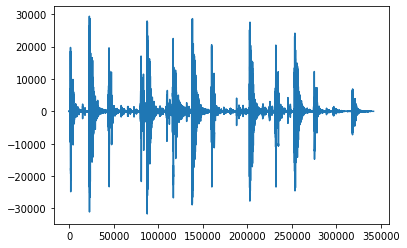

In [134]:
# YOUR CODE HERE

import numpy as np
import matplotlib.pyplot as plt
from scipy.io.wavfile import read
from scipy import signal
from copy import deepcopy
import math

def sound( x, rate=8000, label=''):
    from IPython.display import display, Audio, HTML
    if label is '':
        display( Audio( x, rate=rate))
    else:
        display( HTML( 
        '<style> table, th, td {border: 0px; }</style> <table><tr><td>' + label + 
        '</td><td>' + Audio( x, rate=rate)._repr_html_()[3:] + '</td></tr></table>'
        ))

sr, data = read("loop.wav")
sound(data, rate=sr, label="drum loop")

direct_delay_1m = 0.1 / 340
reflect_delay_1m = math.sqrt((0.1) ** 2 + 2 ** 2) / 340
filter_single_1m = np.zeros(2048, dtype=float)
filter_single_1m[int(direct_delay_1m * sr)] = 1.0
filter_single_1m[int(reflect_delay_1m * sr)] = 0.8

filtered_data1 = np.convolve(filter_single_1m, data, mode='full')
sound(filtered_data1, rate=sr, label="filtered drum loop")

direct_delay_10m = 1 / 340
reflect_delay_10m = math.sqrt((1) ** 2 + 20 ** 2) / 340
filter_single_10m = np.zeros(4096, dtype=float)
filter_single_10m[int(direct_delay_10m * sr)] = 1.0
filter_single_10m[int(reflect_delay_10m * sr)] = 0.5

filtered_data2 = np.convolve(filter_single_10m, data, mode='full')
sound(filtered_data2, rate=sr, label="filtered drum loop 2")
plt.plot(filtered_data2)


b) Now we will use a room geometry as shown below. Design the proper filter again, for $d_i = [0.1, 1]$ meters and then for $d_i = [1, 10]$ meters. Comment on the audible differences between these two settings.

<img src="https://drive.google.com/uc?export=download&id=1uYqG6VqhPegoxuJwvJCqm0zY7Ced-3Ih" title="Room for part 1.b" width=200 >

In [135]:
filter_double_1m = np.zeros(44000, dtype=float)
i = 0
while True:
    if int(2 * sr / 340) * i > 44000:
        break
    filter_double_1m[int(2 * sr / 340) * i] = 1.0 * ((0.8) ** i)
    i += 1

filtered_data1 = np.convolve(filter_double_1m, data, mode='full')
sound(filtered_data1, rate=sr, label="filtered drum loop1")

filter_double_10m = np.zeros(44000, dtype=float)
i = 0
while True:
    if int(20 * sr / 340) * i > 44000:
        break
    filter_double_10m[int(20 * sr / 340) * i] = 1.0 * ((0.5) ** i)
    i += 1

filtered_data2 = np.convolve(filter_double_10m, data, mode='full')
sound(filtered_data2, rate=sr, label="filtered drum loop2")
    


filtered drum loop1


filtered drum loop2


c) Since for small values of $d$ the output above gets its spectrum altered, we will use an allpass filter to make a more natural sounding echo pattern. Use the formulation shown in the lecture slides and compare that filter’s frequency response with the response from the filter in the section b) above.

allpass drum loop 1m


allpass drum loop2 10m


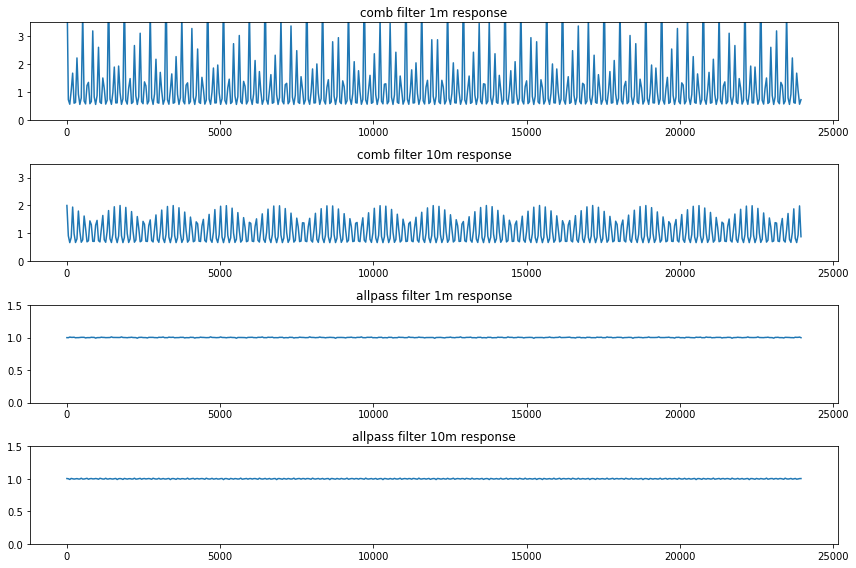

In [136]:
# YOUR CODE HERE

def show_response(fig, freqz, title=""):
    fig.plot(freqz[0], abs(freqz[1]))
    fig.set_title(title)
    
fig, (comb_filter1_response, comb_filter2_response, allpass_filter_1m_response, allpass_filter_10m_response) = plt.subplots(nrows=4)

show_response(comb_filter1_response, signal.freqz(filter_double_1m, fs=sr), title="comb filter 1m response")
comb_filter1_response.set_ylim(0, 3.5)
show_response(comb_filter2_response, signal.freqz(filter_double_10m, fs=sr), title="comb filter 10m response")
comb_filter2_response.set_ylim(0, 3.5)

allpass_impulse = np.zeros(4096, dtype=float)
allpass_impulse[0] = 1.0
allpass_double_1m = np.zeros(4096, dtype=float)
delay = int(2 * sr / 340)
for i in range(0, 4096):
    if i - delay < 0:
        allpass_double_1m[i] = 0.7 * allpass_impulse[i]
    else:
        allpass_double_1m[i] = 0.7 * allpass_impulse[i] + allpass_impulse[i - delay] - 0.7 * allpass_double_1m[i - delay]
show_response(allpass_filter_1m_response, signal.freqz(allpass_double_1m, fs=sr), title="allpass filter 1m response")
allpass_filter_1m_response.set_ylim(0, 1.5)

allpass_impulse = np.zeros(22000, dtype=float)
allpass_impulse[0] = 1.0
allpass_double_10m = np.zeros(22000, dtype=float)
delay = int(20 * sr / 340)
for i in range(0, 22000):
    if i - delay < 0:
        allpass_double_10m[i] = 0.5 * allpass_impulse[i]
    else:
        allpass_double_10m[i] = 0.5 * allpass_impulse[i] + allpass_impulse[i - delay] - 0.5 * allpass_double_10m[i - delay]
show_response(allpass_filter_10m_response, signal.freqz(allpass_double_10m, fs=sr), title="allpass filter 10m response")
allpass_filter_10m_response.set_ylim(0, 1.5)

filtered_data3 = np.convolve(allpass_double_1m, data, mode='full')
sound(filtered_data3, rate=sr, label="allpass drum loop 1m")

filtered_data4 = np.convolve(allpass_double_10m, data, mode='full')
sound(filtered_data4, rate=sr, label="allpass drum loop2 10m")

    
fig.set_size_inches(12, 8)
fig.tight_layout()
plt.show()

## Part 2. Schroeder reverberators

Now we will combine multiple filters to make a more serious sounding reverb. Implement the structure shown below.

<img src="https://drive.google.com/uc?export=download&id=1ubIkl8Qn3osku39tym2ayxVk6KdC95ui" title="Reverb for part 2" width=600 >

Try to find the necessary parameters for the above structure that makes it sound as good as possible (not too busy, not too subtle). Hint: There is no right answer! Try a few things, see what sounds best and explain why you used the parameters you decided to use. As you come across some bad sounding cases, describe what the problem was.

In [257]:
# YOUR CODE HERE
print(sr)
comb_delays = [10, 15, 20, 25]
comb_filters = np.zeros([4, 47999], dtype=float)
comb_loss = [0.5, 0.45, 0.55, 0.6]

for i in range(0, 4):
    j = 0
    while True:
        if comb_delays[i] * j > 47999:
            break
        comb_filters[i][comb_delays[i] * j] = 1.0 * (comb_loss[i] ** j)
        j += 1
    
combined_filter = comb_filters.sum(axis = 0)
print(combined_filter)
combined_filter[0] = 1
#plt.plot(combined_filter)


allpass_impulse = np.zeros(48000, dtype=float)
allpass_impulse[0] = 1.0
allpass_delays = [80, 90]
allpass_filters = np.zeros([2, 48000], dtype=float)

schroeder_result = np.convolve(combined_filter, data, mode='full')

for i in range(2):
    for j in range(0, 48000):
        if j - allpass_delays[i] < 0:
            allpass_filters[i][j] = 0.2 * allpass_impulse[j]
        else:
            allpass_filters[i][j] = 0.2 * allpass_impulse[j] + allpass_impulse[j - allpass_delays[i]] - 0.2 * allpass_filters[i][j - allpass_delays[i]]


allpass1_result = np.convolve(allpass_filters[0], schroeder_result, mode='full')
allpass2_result = np.convolve(allpass_filters[1], allpass1_result, mode='full')
sound(allpass2_result, rate=sr, label="schroeder result")

        




48000
[4. 0. 0. ... 0. 0. 0.]


schroeder result


The weird metal sound appears when the g is high. But in reality, the g can't be so high unless the room is very small. In this case, the actual sound can be weird too.

## Part 3. Applying a real room response

To apply a more realistic filter we need to use a real room response. Download the St. Andrew’s church room impulse response (Stereo) from:

[ https://openairlib.net/?page_id=683 ]
    
Make sure that the sound you will convolve with it will be at the same sampling rate. This impulse response captures that church’s RIR using two channels. To synthesize a sound in that room you need to convolve it with the impulse response. If your test sound is a single-channel recording, you can simply convolve it with each of the two impulse responses and then use the resulting outputs as the left and right channel. You will notice that using the ```scipy.signal.lfilter``` command for this operation can take very long to compute. For faster convolutions we need to perform this filtering in the frequency domain (using the fast convolution algorithm that we mentioned in the filtering lecture). The function ```numpy.convolve``` automatically does that (if you use an up to date version), otherwise you can directly use ```scipy.signal.fftconvolve```.  Verify that the resulting output sounds like it has been placed inside a church.


In [173]:
sr_church, data_church = read("lyd3_000_ortf_48k.wav")
sr_flower, data_flower = read("lone_flowers.wav")
print(sr_church, sr_flower)

sound(np.transpose(data_church), rate=sr_church, label="church impulse response")
sound(np.transpose(data_flower), rate=sr_flower, label="lone flowers original")

result = [np.convolve(np.transpose(data_flower)[0], np.transpose(data_church)[0], mode='full'), 
          np.convolve(np.transpose(data_flower)[1], np.transpose(data_church)[1], mode='full')]
sound(result, rate=sr_flower, label="lone flowers in the church")



48000 48000


church impulse response


lone flowers original


lone flowers in the church


## Part 4 (extra credit). Measuring a room response.

Measuring a room response is crucial when trying to emulate a real room. In this exercise we will make a simple room response measurement. We will use the technique shown in the lecture slides.

a) Generate a chirp to use as our room excitation signal.

b) Go to a (preferably quiet) room that you want to measure, play the chirp from a speaker and record the outcome (the easiest way to do that is to save this sequence as a wave file and play it while you record a new sound file). You can instead use the real-time I/O code from Lab 0. In doing so you will obtain the sequence $y[t]$ from slide 36.

c) Now you will need to perform the actual deconvolution. Take $x[t]$ and $y[t]$, compute their DFTs to get $X[ω]$ and $Y[ω]$, and estimate $H[ω]$ (remember to zero pad the inputs since the output of the convolution will be about twice as long as the inputs). Take the inverse DFT of $H$ to get the time domain representation of the room impulse response. Does it look like one?

d) Convolve the resulting response with the test sound above (make sure you use the same sample rates). Does it sound reverberated? This won’t be perfect. What sounds “wrong” with it? Can you speculate why?

Chirp


Chirp record


220501 220500


impulse response


lone flowers original


lone flowers in my dorm


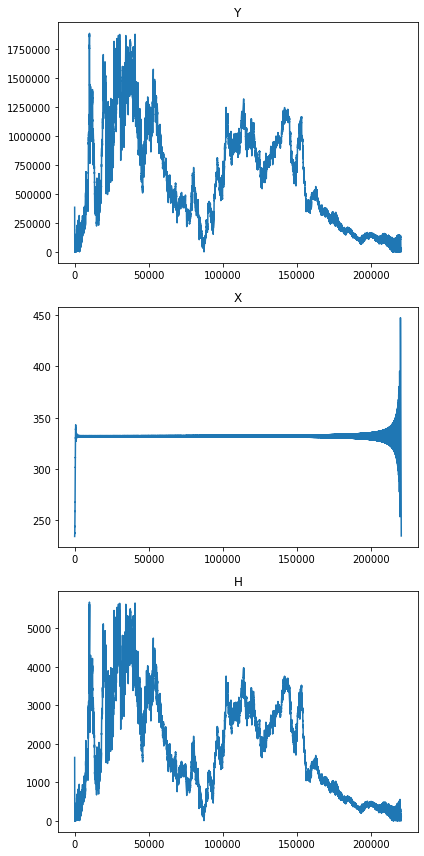

In [259]:
from pysoundcard import Stream

def make_chirp( duration=5, sample_rate=44100):
    data = []
    x = 0
    for i in range(0, sample_rate * duration):
        x += (2 * math.pi) * (i * 0.5 / (sample_rate * duration))
        data.append(np.sin(x))
    return data

chirp = make_chirp(5, 44100)
sound( chirp, rate=44100, label='Chirp')

sr_record, chirp_record = read("chirp_record.wav")
sound( chirp_record.T[0], rate=44100, label='Chirp record')
record_fd = abs(np.fft.rfft(chirp_record.T[0], n=len(chirp)*2))
chirp_fd = abs(np.fft.rfft(chirp, n=len(chirp)*2))

fig, (record_fig, chirp_fig, h_fig) = plt.subplots(nrows=3)

record_fig.plot(record_fd)
record_fig.set_title("Y")
chirp_fig.plot(chirp_fd)
chirp_fig.set_title("X")
h = record_fd / chirp_fd
h_fig.plot(h)
h_fig.set_title("H")

ir = np.fft.irfft(h)
print(len(h), len(chirp))
sound( ir[:44100], rate=44100, label='impulse response')

sr_flower_441, data_flower_441 = read("lone_flowers_44100.wav")
sound(np.transpose(data_flower_441), rate=sr_flower_441, label="lone flowers original")

flower_dorm = [np.convolve(np.transpose(data_flower_441)[0], ir[:44100], mode='full'), 
               np.convolve(np.transpose(data_flower_441)[1], ir[:44100], mode='full')]

sound(flower_dorm, rate=sr_flower_441, label="lone flowers in my dorm")

fig.set_size_inches(6, 12)
fig.tight_layout()
plt.show()







Ans: The sound does not reverberate, because my microphone does not sensitive enough to record the reberb. Furthermore, it sounds flat than original because the microphone sensitivity at middle range of frequency is particularly dull, causing the measured impulse response different from the actual one.